# Sybil Model Report
by Nikita Kozlov

This notebook demonstrates how to use the Sybil model to predict the lung cancer probability for each patient scan and generate a report with the predictions and attention visualizations.

The notebook provides the following functionality:
1. It loads the Sybil model and prepares the data for prediction.
2. It predicts the lung cancer probability for each patient scan.
3. It generates attention visualizations for each patient scan.
4. It generates a report with the predictions scores per patient scan per year.

The notebook requires the following files:
- `data` directory with the patient scans in NLST format. Example of the data directory structure:
    ```
    data
    ├── manifest-1725486726463 (manifest file is provided in the repository)
         ├── NLST
             ├── <Patient ID>
                 ├── <Scan ID>
                     ├── <Series ID>
                         ├── <DICOM files> (1-0001.dcm, 1-0002.dcm, ...)
             ├── ...
    ```

The notebook generates the following files:
- `results` directory with the attention visualizations for each patient scan.
- `predictions_per_patient.pkl` file with the predictions per patient scan cache.
- `report.csv` file with the predictions scores per patient scan per year.

In [ ]:
!pip install "git+https://github.com/reginabarzilaygroup/Sybil.git"
!pip install pydicom torch==2.4.1 pandas

In [1]:
DATA_PATH = "data"
RESULTS_PATH = "results"
PREDICTIONS_CACHE_PATH = "predictions_per_patient.pkl"

In [2]:
import logging
import random
from sybil import Sybil
from utils import *

disable_warnings()
set_global_seed()
logging.basicConfig(level=logging.INFO)

# Load the model
model = Sybil("sybil_ensemble", device=detect_device())

/opt/anaconda3/envs/workspace/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: dlopen(/opt/anaconda3/envs/workspace/lib/python3.10/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c1017RegisterOperatorsD1Ev
  Referenced from: <0B637046-A38B-3A5C-80C6-E847C27DCCD5> /opt/anaconda3/envs/workspace/lib/python3.10/site-packages/torchvision/image.so
  Expected in:     <CC2A0259-414A-3562-95F8-DB0DE0A75BD7> /opt/anaconda3/envs/workspace/lib/python3.10/site-packages/torch/lib/libtorch_cpu.dylib
  warn(f"Failed to load image Python extension: {e}")
INFO:sybil-process-8783:Loaded model from /Users/nk2/.sybil/28a7cd44f5bcd3e6cc760b65c7e0d54d.ckpt
INFO:sybil-process-8783:Loaded model from /Users/nk2/.sybil/56ce1a7d241dc342982f5466c4a9d7ef.ckpt
INFO:sybil-process-8783:Loaded model from /Users/nk2/.sybil/624407ef8e3a2a009f9fa51f9846fe9a.ckpt
INFO:sybil-process-8783:Loaded model from /Users/nk2/.sybil/64a91b25f84141d32852e7

## Load the data

The data is loaded from the `data` directory with the patient scans in NLST format. 
Some dcm files may be corrupted, so we skip patient scans valid series. 
Sybil requires Slice Thickness to be less than 5.0, so we skip the dcm files with Slice Thickness greater than 5.0.

In [3]:
import os

# Load the data
patient_scans = [
    PatientScan.from_path(root, files)
    for root, directories, files in os.walk(DATA_PATH)
    if not directories
]

logging.info(f"Loaded {len(patient_scans)} patient scans")

INFO:root:Loaded 33 patient scans


## Predict the lung cancer probability for each patient scan

We predict the lung cancer probability for each patient scan using the Sybil model. 
Sybil model produces attention maps for each slice in the CT scan. We save the attention maps as GIFs in the `results` directory.
It also generates a series of scores for each patient scan, that represent the probability of lung cancer for 6 years.

In [4]:
from typing import List

predictions_per_patient: List[PatientScanPrediction] = []

for patient_scan in patient_scans:
    serie = patient_scan.serie()
    if serie is None:
        logging.warning(f"Patient {patient_scan.patient_id} - {patient_scan.scan_id} - {patient_scan.series_id} has no series")
        continue
    
    logging.info(f"Predicting for patient {patient_scan.patient_id} - {patient_scan.scan_id} - {patient_scan.series_id}")
    predictions = model.predict([serie], return_attentions=True)
    predictions_per_patient.append(PatientScanPrediction(patient_scan, serie, predictions.scores[0], predictions.attentions))

logging.info(f"Predicted {len(predictions_per_patient)} patient scans")

INFO:root:Predicting for patient 100004 - 01-02-2000-NA-NLST-LSS-74562 - 1.000000-1OPAGELSPLUSD4102.512080.00.11.5-69408
INFO:root:Predicting for patient 100004 - 01-02-2000-NA-NLST-LSS-74562 - 1.000000-1OPAGELSPLUSLUNG4102.512080.00.11.5-36531
INFO:root:Predicting for patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPATOAQUL4C410.22-68378
INFO:root:Predicting for patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPLTOAQUL4FL01500na-26939
INFO:root:Predicting for patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPATOAQUL4C410.22-06725
INFO:root:Predicting for patient 100004 - 01-02-1999-NA-NLST-LSS-63991 - 1.000000-0OPAGELSPLUSLUNG4102.512080.00.10.75-94287
INFO:root:Predicting for patient 100004 - 01-02-1999-NA-NLST-LSS-63991 - 1.000000-0OPAGELSPLUSD4102.512080.00.10.75-24639
INFO:root:Predicting for patient 100002 - 01-02-1999-NA-NLST-LSS-55322 - 1.000000-0OPAGELSPLUSLUNG3602.512080.00.11.5-04792
INFO:root:Predicting for patient 100002 - 01-02-1999-NA-NLST-

This is done to cache the predictions per patient scan as it may take a long time to predict values.

In [7]:
import pickle

with open(PREDICTIONS_CACHE_PATH, "wb") as file:
    pickle.dump(predictions_per_patient, file)

In [3]:
import pickle

with open(PREDICTIONS_CACHE_PATH, "rb") as file:
    predictions_per_patient = pickle.load(file)

## Generate attention visualizations for each patient scan

The attention visualizations are generated for each patient scan. They are saved as GIFs in the `results` directory.

In [8]:
from sybil import visualize_attentions

for prediction in predictions_per_patient:
    logging.info(f"Generating attentions visualization for patient {prediction.scan.patient_id} - {prediction.scan.scan_id} - {prediction.scan.series_id}")
    series_with_attention = visualize_attentions(
        prediction.serie,
        attentions = prediction.attentions,
        save_directory=str(os.path.join(RESULTS_PATH, prediction.scan.patient_id, prediction.scan.scan_id, prediction.scan.series_id)),
        gain=3,
    )

INFO:root:Generating attentions visualization for patient 100004 - 01-02-2000-NA-NLST-LSS-74562 - 1.000000-1OPAGELSPLUSD4102.512080.00.11.5-69408
INFO:root:Generating attentions visualization for patient 100004 - 01-02-2000-NA-NLST-LSS-74562 - 1.000000-1OPAGELSPLUSLUNG4102.512080.00.11.5-36531
INFO:root:Generating attentions visualization for patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPATOAQUL4C410.22-68378
INFO:root:Generating attentions visualization for patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPLTOAQUL4FL01500na-26939
INFO:root:Generating attentions visualization for patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPATOAQUL4C410.22-06725
INFO:root:Generating attentions visualization for patient 100004 - 01-02-1999-NA-NLST-LSS-63991 - 1.000000-0OPAGELSPLUSLUNG4102.512080.00.10.75-94287
INFO:root:Generating attentions visualization for patient 100004 - 01-02-1999-NA-NLST-LSS-63991 - 1.000000-0OPAGELSPLUSD4102.512080.00.10.75-24639
INFO:root:

## Sample attention visualization

INFO:root:Patient 100004 - 01-02-2001-NA-NLST-LSS-01308 - 1.000000-2OPATOAQUL4C410.22-68378
INFO:root:Scores: [0.00042105263157894734, 0.0020480077233631737, 0.005017651482467496, 0.008837064568505281, 0.014169944457552302, 0.021661887350000762]


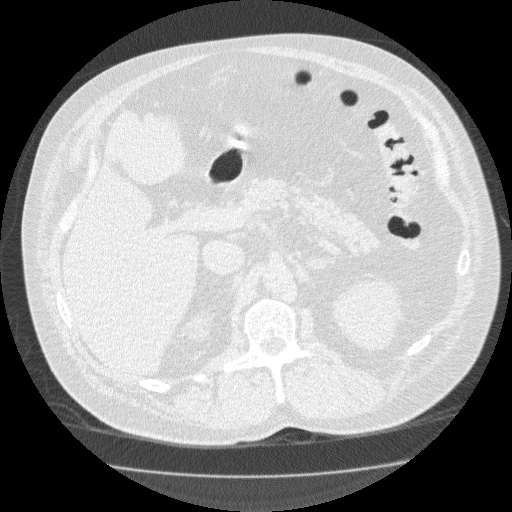

In [6]:
# Show sample gif
from IPython.display import Image

sample_prediction = random.choice(predictions_per_patient)

logging.info(f"Patient {sample_prediction.scan.patient_id} - {sample_prediction.scan.scan_id} - {sample_prediction.scan.series_id}")
logging.info(f"Scores: {sample_prediction.scores}")
Image(filename=str(os.path.join(RESULTS_PATH, sample_prediction.scan.patient_id, sample_prediction.scan.scan_id, sample_prediction.scan.series_id, "serie_0", "serie_0.gif")))

## Generate a report

The report is generated with the predictions scores per patient scan per year into a CSV file.

In [5]:
import pandas as pd

# Generate a report
report = pd.DataFrame([
    prediction.to_dict()
    for prediction in predictions_per_patient
])

report = report.sort_values(by=["Patient ID", "Scan ID", "Series ID"], ascending=[True, True, True])
report = report.reset_index(drop=True)

report.to_csv("report.csv", index=False)
report

,Patient ID,Scan ID,Series ID,Score Y1,Score Y2,Score Y3,Score Y4,Score Y5,Score Y6
0,100002,01-02-1999-NA-NLST-LSS-55322,1.000000-0OPAGELSPLUSD3602.512080.00.11.5-35858,0.006722,0.020146,0.038154,0.056078,0.068311,0.104019
1,100002,01-02-1999-NA-NLST-LSS-55322,1.000000-0OPAGELSPLUSLUNG3602.512080.00.11.5-0...,0.000421,0.002048,0.007460,0.010839,0.015321,0.027271
2,100002,01-02-2000-NA-NLST-LSS-11765,1.000000-1OPAGELSPLUSD3602.512080.00.11.5-72875,0.001170,0.002554,0.007835,0.011039,0.018442,0.030890
3,100002,01-02-2000-NA-NLST-LSS-11765,1.000000-1OPAGELSPLUSLUNG3602.512080.00.11.5-0...,0.000000,0.001574,0.004032,0.006847,0.010381,0.019111
4,100002,01-02-2001-NA-NLST-LSS-80878,1.000000-2OPAGELSPLUSD3602.512080.00.11.5-15470,0.001170,0.002554,0.007835,0.011039,0.018442,0.030890
5,100002,01-02-2001-NA-NLST-LSS-80878,1.000000-2OPAGELSPLUSLUNG3602.512080.00.11.5-3...,0.001170,0.002048,0.007460,0.010839,0.015321,0.026090
6,100004,01-02-1999-NA-NLST-LSS-63991,1.000000-0OPAGELSPLUSD4102.512080.00.10.75-24639,0.002824,0.011459,0.015790,0.024725,0.034641,0.052931
7,100004,01-02-1999-NA-NLST-LSS-63991,1.000000-0OPAGELSPLUSLUNG4102.512080.00.10.75-...,0.001965,0.011459,0.015790,0.024725,0.034510,0.048361
8,100004,01-02-2000-NA-NLST-LSS-74562,1.000000-1OPAGELSPLUSD4102.512080.00.11.5-69408,0.001170,0.002048,0.007460,0.010839,0.015321,0.028559
9,100004,01-02-2000-NA-NLST-LSS-74562,1.000000-1OPAGELSPLUSLUNG4102.512080.00.11.5-3...,0.000421,0.002048,0.005018,0.008837,0.012543,0.021662
